In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import time

In [2]:
data = pd.read_csv('/home/sahil/Documents/Housing(1).csv')

def binary_encode(column):
    binary= lambda x: 1 if x == 'yes' else 0
    data[column] = data[column].map(binary)

def binary_encode1(column):
    binary =lambda x: 1 if x=='furnished' else(0 if x=='semifurnished' else 2)
    data[column] = data[column].map(binary)

binary_encode('mainroad')
binary_encode('guestroom')
binary_encode('basement')
binary_encode('hotwaterheating')
binary_encode('airconditioning')
binary_encode('prefarea')
binary_encode1('furnishingstatus')

In [3]:
def min_max_y(y):
    normalized_y= np.empty_like(y, dtype=float)
    min_vals =np.min(y)
    max_vals =np.max(y)
    normalized_y = (y - min_vals) / (max_vals-min_vals)
    return normalized_y

def min_max_scaling(data,y):
    normalized_data = np.empty_like(data, dtype=float)
    for i in range(0,12):
        min_vals =min(data[:,i])
        max_vals =max(data[:,i])
        normalized_data[:,i] = (data[:,i] - min_vals) / (max_vals-min_vals)
    return normalized_data

In [4]:
y=data['price']
data.drop(columns=['price'],inplace=True)
data=pd.DataFrame(data)
y=pd.DataFrame(y)
y=y.values
ymean = np.mean(y)
ystd = np.std(y)
arr_data=data.values
normalized_y=min_max_y(y)
normalized_data=min_max_scaling(arr_data,y)

In [5]:
w = np.random.randn(normalized_data.shape[1], 1)
b = 2

def linear_regression_f(x,y,w,b):
    initial_learning_rate =0.00009
    p=[]
    m=[]
    s=[]
    cur_time=time.time()
    for epoch in range(1,1000000):
        a=np.dot(x,w)+b
        dw=((x.T).dot(a-y))/x.shape[0]
        db=np.sum((a-y))/x.shape[0]
        w=w-initial_learning_rate*(dw)
        b=b-initial_learning_rate*(db)
        l=(np.mean((y-a)**2))
        p.append(l)
        m.append(epoch)
        # s.append(a)
        print(f"loss ={l:.2e}")
    aft_time=time.time()
    print(aft_time-cur_time)
    
    y = ymean + y*ystd
    a = ymean + a*ystd

    f1=plt.figure(1)
    plt.scatter(y,a,color='blue')
    # plt.plot(y,a)
    plt.xlabel('actual price')
    plt.ylabel('predicted price')
    plt.title('scatter')

    f1=plt.figure(2)
    plt.plot(m,p)
    plt.xlabel('m')
    plt.ylabel('p')
    plt.title('Graph')
    plt.show()

    print(w)
    print(b)

loss =1.78e+01
loss =1.78e+01
loss =1.78e+01
loss =1.78e+01
loss =1.78e+01
loss =1.78e+01
loss =1.78e+01
loss =1.78e+01
loss =1.78e+01
loss =1.78e+01
loss =1.78e+01
loss =1.78e+01
loss =1.77e+01
loss =1.77e+01
loss =1.77e+01
loss =1.77e+01
loss =1.77e+01
loss =1.77e+01
loss =1.77e+01
loss =1.77e+01
loss =1.77e+01
loss =1.77e+01
loss =1.77e+01
loss =1.76e+01
loss =1.76e+01
loss =1.76e+01
loss =1.76e+01
loss =1.76e+01
loss =1.76e+01
loss =1.76e+01
loss =1.76e+01
loss =1.76e+01
loss =1.76e+01
loss =1.76e+01
loss =1.76e+01
loss =1.75e+01
loss =1.75e+01
loss =1.75e+01
loss =1.75e+01
loss =1.75e+01
loss =1.75e+01
loss =1.75e+01
loss =1.75e+01
loss =1.75e+01
loss =1.75e+01
loss =1.75e+01
loss =1.74e+01
loss =1.74e+01
loss =1.74e+01
loss =1.74e+01
loss =1.74e+01
loss =1.74e+01
loss =1.74e+01
loss =1.74e+01
loss =1.74e+01
loss =1.74e+01
loss =1.74e+01
loss =1.74e+01
loss =1.73e+01
loss =1.73e+01
loss =1.73e+01
loss =1.73e+01
loss =1.73e+01
loss =1.73e+01
loss =1.73e+01
loss =1.73e+01
loss =1.73

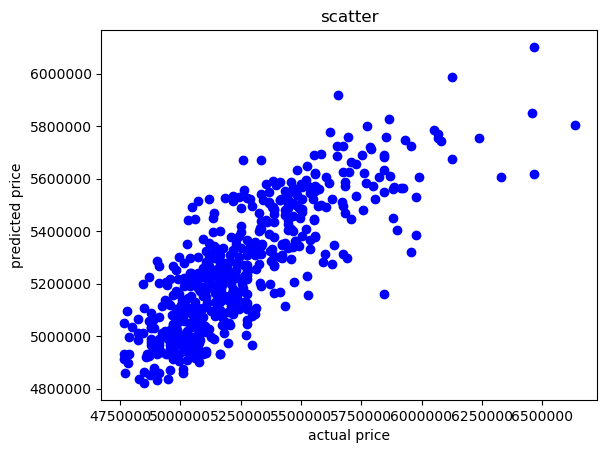

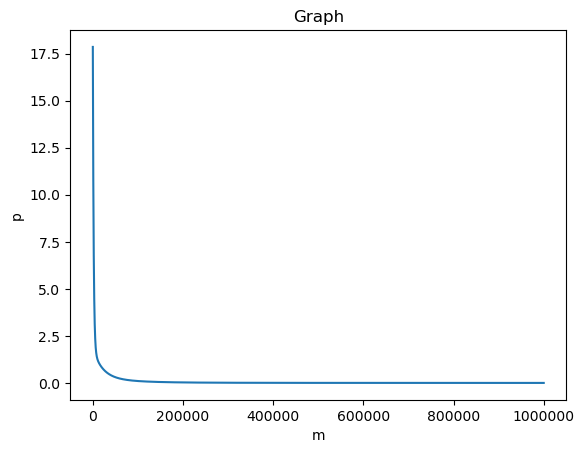

[[ 0.19293007]
 [ 0.10212938]
 [ 0.19426219]
 [ 0.11876565]
 [ 0.04293338]
 [ 0.03282631]
 [ 0.02970229]
 [ 0.08753291]
 [ 0.08047098]
 [ 0.09844269]
 [ 0.06316947]
 [-0.0225516 ]]
0.021315588698306447


In [6]:
linear_regression_f(normalized_data,normalized_y,w,b)